In [4]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [5]:
import os
os.chdir('/content/drive/MyDrive/Satyam_Verma_project')

In [29]:
import pandas as pd
data = pd.read_csv('image_paths_with_degraded.csv')
data.head()

,GT_clean_image,Defect_mask,Degraded_image
0,Denoising_Dataset_train_val/bottle/Train/GT_cl...,Denoising_Dataset_train_val/bottle/Train/Defec...,Denoising_Dataset_train_val/bottle/Train/Degra...
1,Denoising_Dataset_train_val/bottle/Train/GT_cl...,Denoising_Dataset_train_val/bottle/Train/Defec...,Denoising_Dataset_train_val/bottle/Train/Degra...
2,Denoising_Dataset_train_val/bottle/Train/GT_cl...,Denoising_Dataset_train_val/bottle/Train/Defec...,Denoising_Dataset_train_val/bottle/Train/Degra...
3,Denoising_Dataset_train_val/bottle/Train/GT_cl...,Denoising_Dataset_train_val/bottle/Train/Defec...,Denoising_Dataset_train_val/bottle/Train/Degra...
4,Denoising_Dataset_train_val/bottle/Train/GT_cl...,Denoising_Dataset_train_val/bottle/Train/Defec...,Denoising_Dataset_train_val/bottle/Train/Degra...


In [30]:
data = data[:1000]

In [31]:
from sklearn.model_selection import train_test_split
train, test = train_test_split(data, test_size=0.2, random_state=42)
train, val = train_test_split(train, test_size=0.2, random_state=42)

In [32]:
import tensorflow as tf
from tensorflow.keras import layers, models

# Define the UNet model
def unet_model(input_size=(256, 256, 3)):
    inputs = layers.Input(input_size)

    # Encoder (downsampling)
    c1 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(inputs)
    c1 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(c1)
    p1 = layers.MaxPooling2D((2, 2))(c1)

    c2 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(p1)
    c2 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(c2)
    p2 = layers.MaxPooling2D((2, 2))(c2)

    c3 = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(p2)
    c3 = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(c3)
    p3 = layers.MaxPooling2D((2, 2))(c3)

    c4 = layers.Conv2D(512, (3, 3), activation='relu', padding='same')(p3)
    c4 = layers.Conv2D(512, (3, 3), activation='relu', padding='same')(c4)
    p4 = layers.MaxPooling2D(pool_size=(2, 2))(c4)

    # Bottleneck
    c5 = layers.Conv2D(1024, (3, 3), activation='relu', padding='same')(p4)
    c5 = layers.Conv2D(1024, (3, 3), activation='relu', padding='same')(c5)

    # Decoder (upsampling)
    u6 = layers.Conv2DTranspose(512, (2, 2), strides=(2, 2), padding='same')(c5)
    u6 = layers.concatenate([u6, c4])
    c6 = layers.Conv2D(512, (3, 3), activation='relu', padding='same')(u6)
    c6 = layers.Conv2D(512, (3, 3), activation='relu', padding='same')(c6)

    u7 = layers.Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(c6)
    u7 = layers.concatenate([u7, c3])
    c7 = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(u7)
    c7 = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(c7)

    u8 = layers.Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c7)
    u8 = layers.concatenate([u8, c2])
    c8 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(u8)
    c8 = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(c8)

    u9 = layers.Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c8)
    u9 = layers.concatenate([u9, c1], axis=3)
    c9 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(u9)
    c9 = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(c9)

    # Output layer with the same dimensions as the input
    outputs = layers.Conv2D(3, (1, 1), activation='sigmoid')(c9)

    # Compile the model
    model = models.Model(inputs=[inputs], outputs=[outputs])
    return model

# Instantiate the model
input_shape = (256, 256, 3)  # Update this if your images are a different size
model = unet_model(input_shape)

# Display the model architecture
model.summary()


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1             │ (None, 256, 256, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_19 (Conv2D)        │ (None, 256, 256, 64)   │          1,792 │ input_layer_1[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_20 (Conv2D)        │ (None, 256, 256, 64)   │         36,928 │ conv2d_19[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_4           │ (None, 128, 128, 64)   │              0 │ conv2d_20[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_21 (Conv2D)        │ (None, 128, 128, 128)  │         73,856 │ max_pooling2d_4[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_22 (Conv2D)        │ (None, 128, 128, 128)  │        147,584 │ conv2d_21[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_5           │ (None, 64, 64, 128)    │              0 │ conv2d_22[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_23 (Conv2D)        │ (None, 64, 64, 256)    │        295,168 │ max_pooling2d_5[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_24 (Conv2D)        │ (None, 64, 64, 256)    │        590,080 │ conv2d_23[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_6           │ (None, 32, 32, 256)    │              0 │ conv2d_24[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_25 (Conv2D)        │ (None, 32, 32, 512)    │      1,180,160 │ max_pooling2d_6[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_26 (Conv2D)        │ (None, 32, 32, 512)    │      2,359,808 │ conv2d_25[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_7           │ (None, 16, 16, 512)    │              0 │ conv2d_26[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_27 (Conv2D)        │ (None, 16, 16, 1024)   │      4,719,616 │ max_pooling2d_7[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_28 (Conv2D)        │ (None, 16, 16, 1024)   │      9,438,208 │ conv2d_27[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_transpose_4        │ (None, 32, 32, 512)    │      2,097,664 │ conv2d_28[0][0]        │
│ (Conv2DTranspose)         │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_4        

 Total params: 31,031,875 (118.38 MB)

 Trainable params: 31,031,875 (118.38 MB)

 Non-trainable params: 0 (0.00 B)

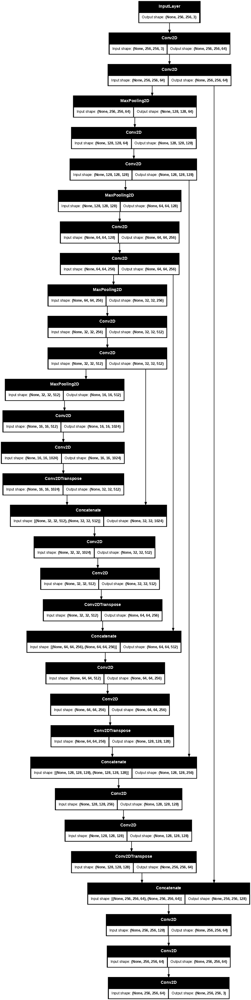

In [10]:
tf.keras.utils.plot_model(model, show_shapes=True, expand_nested=True, dpi=64)

In [33]:
from sklearn.model_selection import train_test_split
import pandas as pd
import numpy as np
import cv2
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.model_selection import train_test_split
img_height, img_width = 256, 256
batch_size = 8
epochs = 50

# Data generator to load dual inputs and masks
class DualInputDataGenerator(tf.keras.utils.Sequence):
    def __init__(self, image_paths_1, mask_paths, batch_size, img_height, img_width):
        self.image_paths_1 = image_paths_1
        self.mask_paths = mask_paths
        self.batch_size = batch_size
        self.img_height = img_height
        self.img_width = img_width
        self.indices = np.arange(len(self.image_paths_1))

    def __len__(self):
        return len(self.image_paths_1) // self.batch_size

    def __getitem__(self, index):
        batch_indices = self.indices[index * self.batch_size:(index + 1) * self.batch_size]
        images_1 = np.array([self.load_image(self.image_paths_1[i]) for i in batch_indices])
        masks = np.array([self.load_image(self.mask_paths[i]) for i in batch_indices])
        return images_1, masks

    def load_image(self, path, is_mask=False):
        img = cv2.imread(path, cv2.IMREAD_GRAYSCALE if is_mask else cv2.IMREAD_COLOR)
        img = cv2.resize(img, (self.img_width, self.img_height))
        img = img / 255.0  # Normalize
        if is_mask:
            img = np.expand_dims(img, axis=-1)  # Add channel dimension for mask
        return img

# Split data into training and validation sets
train_data, val_data = train_test_split(data, test_size=0.2, random_state=42)
train_gen = DualInputDataGenerator(train_data['Degraded_image'].values, train_data['GT_clean_image'].values, batch_size, img_height, img_width)
val_gen = DualInputDataGenerator(val_data['Degraded_image'].values, val_data['GT_clean_image'].values, batch_size, img_height, img_width)


In [34]:
import tensorflow as tf
import matplotlib.pyplot as plt
from IPython.display import clear_output

def display(display_list, title_list=['Input Image', 'True Output', 'Predicted Output']):
    plt.figure(figsize=(15, 5))

    for i in range(len(display_list)):
        plt.subplot(1, len(display_list), i + 1)
        plt.title(title_list[i])
        plt.imshow(tf.keras.preprocessing.image.array_to_img(display_list[i]))
        plt.axis('off')
    plt.show()

class DisplayCallback(tf.keras.callbacks.Callback):
    def __init__(self, dataset, num_samples=3):
        super().__init__()
        self.dataset = dataset
        self.num_samples = num_samples

    def on_epoch_end(self, epoch, logs=None):
        clear_output(wait=True)
        # Randomly sample batches to display
        for _ in range(self.num_samples):
            # Get a random batch
            idx = np.random.randint(0, len(self.dataset))  # <-- Changed line: sampling a random batch index
            images, masks = self.dataset[idx]               # <-- Changed line: getting the batch by index
            preds = self.model.predict(images)

            # Display each sample in the batch
            for i in range(len(images)):
                display([images[i], masks[i], preds[i]])
        print(f'\nSample Predictions after epoch {epoch + 1}\n')



In [35]:
def ssim(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32)  # Cast y_true to float32
    y_pred = tf.cast(y_pred, tf.float32)  # Cast y_pred to float32, if necessary
    return tf.image.ssim(y_true, y_pred, max_val=1.0)


In [36]:
def psnr(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32)  # Ensure y_true is float32
    y_pred = tf.cast(y_pred, tf.float32)  # Ensure y_pred is float32
    return tf.image.psnr(y_true, y_pred, max_val=1.0)


In [37]:
model.compile(
    optimizer='adam',
    loss='binary_crossentropy',
    metrics=['accuracy', psnr, ssim]
)


In [40]:
import tensorflow as tf
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, TensorBoard, Callback


class CustomMetricsCallback(Callback):
    def on_epoch_end(self, epoch, logs=None):
        logs = logs or {}
        psnr = logs.get('psnr_metric')
        ssim = logs.get('ssim_metric')
        print(f"Ending Epoch {epoch+1}, PSNR: {psnr}, SSIM: {ssim}")


early_stopping_callback = EarlyStopping(
    monitor='val_loss',
    patience=2,                    # Number of epochs with no improvement after which training will be stopped
    restore_best_weights=True,      # Restore model weights from the epoch with the best value of the monitored quantity
    verbose=1
)

In [42]:
#display_callback = DisplayCallback(dataset=train_gen, num_samples=3)

##model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Start training
history = model.fit(
    train_gen,  # Make sure this is repeated
    steps_per_epoch=len(train_gen) // 16,  # Adjust as per your dataset
    epochs=10,
    validation_data=val_gen,  # Ensure validation data also repeats if it's a generator
    validation_steps=50,  # Adjust according to the size of your validation data
    callbacks=[early_stopping_callback],
    verbose=1
)


Epoch 1/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 591ms/step - accuracy: 0.5389 - loss: 0.5512 - psnr: 23.4776 - ssim: 0.6322

/usr/lib/python3.10/contextlib.py:153: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(typ, value, traceback)


6/6 ━━━━━━━━━━━━━━━━━━━━ 26s 4s/step - accuracy: 0.5436 - loss: 0.5507 - psnr: 23.5054 - ssim: 0.6336 - val_accuracy: 0.6297 - val_loss: 0.5411 - val_psnr: 23.2635 - val_ssim: 0.6531
Epoch 2/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 21s 4s/step - accuracy: 0.5778 - loss: 0.5354 - psnr: 24.2997 - ssim: 0.6920 - val_accuracy: 0.6177 - val_loss: 0.5381 - val_psnr: 24.1534 - val_ssim: 0.6631
Epoch 3/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 19s 4s/step - accuracy: 0.6894 - loss: 0.5194 - psnr: 23.6316 - ssim: 0.6636 - val_accuracy: 0.5629 - val_loss: 0.5365 - val_psnr: 24.4687 - val_ssim: 0.6706
Epoch 4/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 25s 5s/step - accuracy: 0.5964 - loss: 0.5109 - psnr: 24.5389 - ssim: 0.6757 - val_accuracy: 0.7363 - val_loss: 0.5392 - val_psnr: 23.3497 - val_ssim: 0.6704
Epoch 5/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 18s 4s/step - accuracy: 0.7795 - loss: 0.5510 - psnr: 23.7598 - ssim: 0.6599 - val_accuracy: 0.5947 - val_loss: 0.5364 - val_psnr: 24.5184 - val_ssim: 0.6628
Epoch 6/10
6/6 ━━━━━━━━━━━━━━━━━━━━ 18s 4

In [43]:
model.save('image_restoration_model.h5', include_optimizer=False)  # Exclude optimizer to avoid loading issues


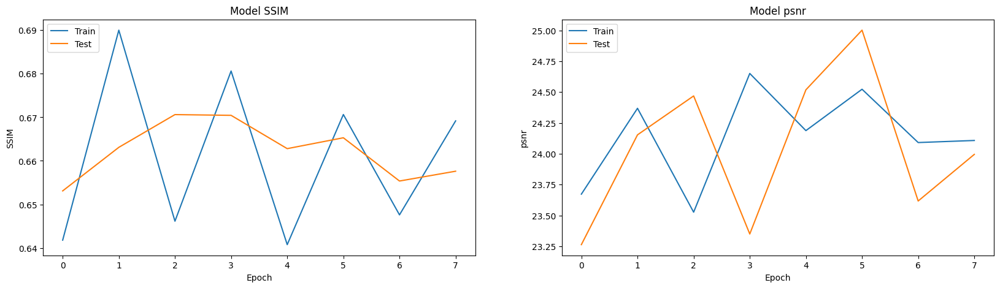

In [45]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20, 5))
plt.subplot(121)
plt.plot(history.history['ssim'])
plt.plot(history.history['val_ssim'])
plt.title('Model SSIM')
plt.ylabel('SSIM')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')

# Plot training & validation f1_score
plt.subplot(122)
plt.plot(history.history['psnr'])
plt.plot(history.history['val_psnr'])
plt.title('Model psnr')
plt.ylabel('psnr')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

## Inference

In [46]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import load_model

# Load the trained model
#model = load_model('image_restoration_model.h5')

In [47]:
def preprocess_image(image_path, target_size):
    # Load the image file, ensuring it's resized to match the model's expected input
    img = load_img(image_path, target_size=target_size)
    img_array = img_to_array(img)  # Convert the image to an array
    img_array = img_array / 255.0  # Scale the image to the [0, 1] range
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    return img_array


In [51]:
def predict_and_display(image_path, Actual_image,  model):
    # Assume the model expects images of size 256x256
    img_array = preprocess_image(image_path, target_size=(256, 256))
    actual_array = preprocess_image(Actual_image, target_size=(256, 256))

    # Predict the output using the loaded model
    pred = model.predict(img_array)

    # Display the original image and the prediction
    fig, axes = plt.subplots(1, 3, figsize=(12, 6))
    axes[0].imshow(tf.keras.preprocessing.image.array_to_img(img_array[0]))
    axes[0].set_title('Original Image')
    axes[0].axis('off')

    axes[1].imshow(tf.keras.preprocessing.image.array_to_img(actual_array[0]))
    axes[1].set_title('Actual Image')
    axes[1].axis('off')

    axes[2].imshow(tf.keras.preprocessing.image.array_to_img(pred[0]))
    axes[2].set_title('Model Prediction')
    axes[2].axis('off')



    plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


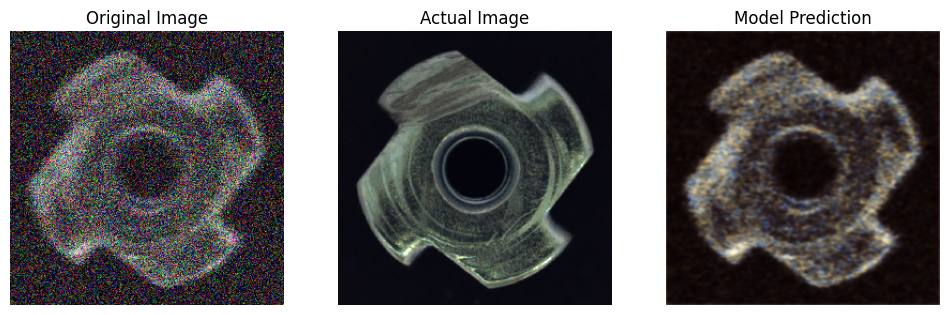

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


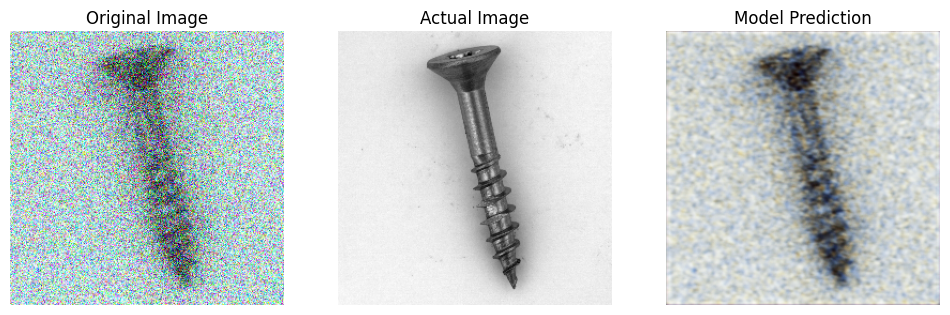

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


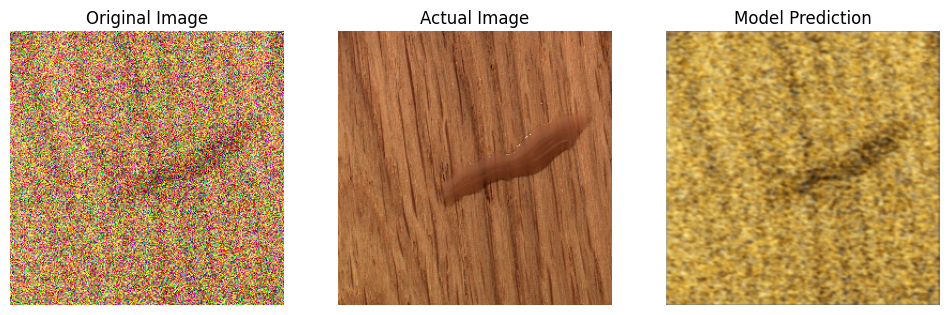

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


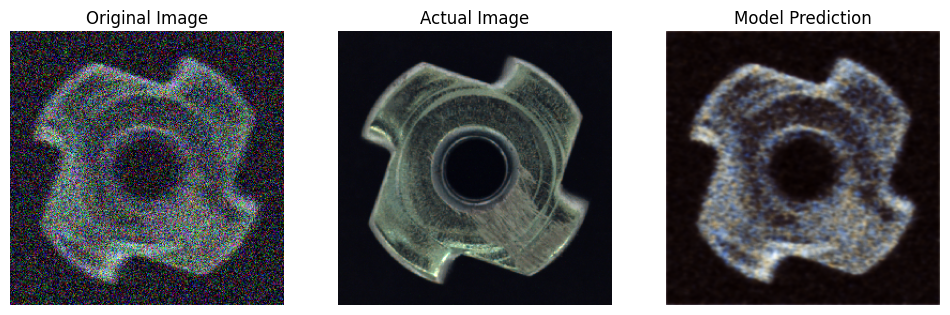

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


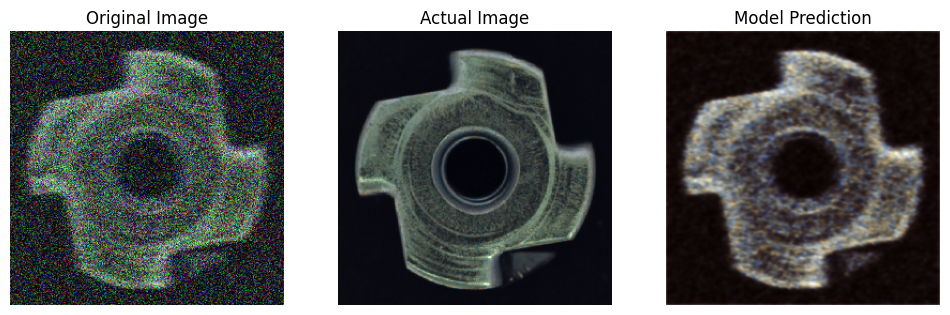

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


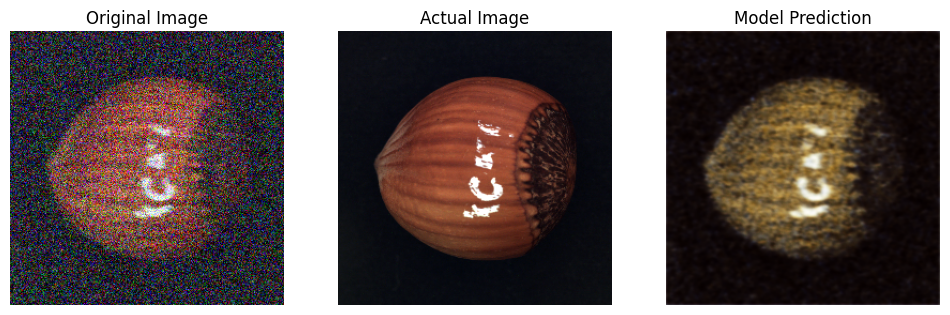

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


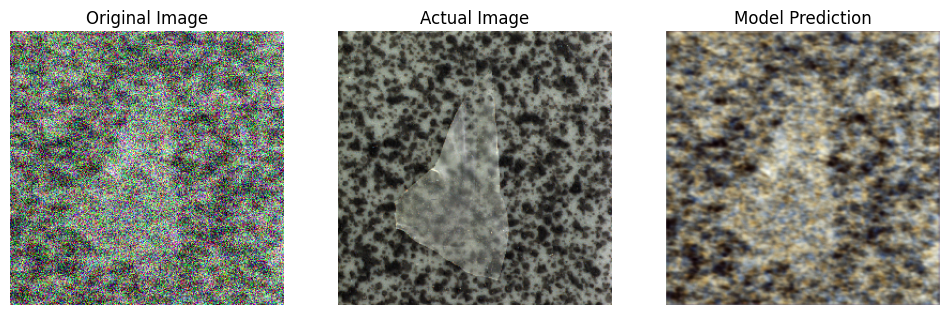

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


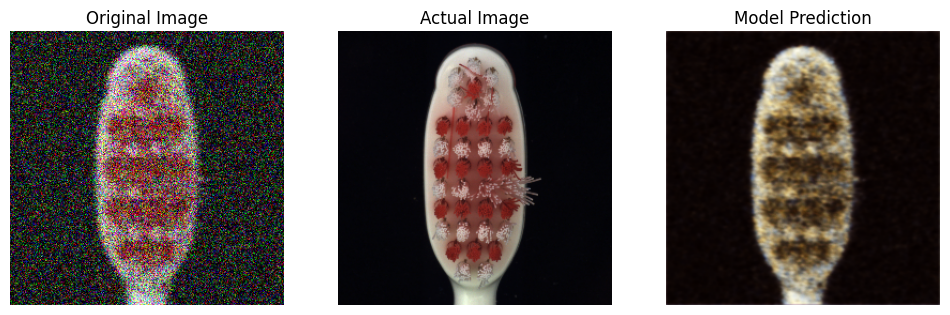

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


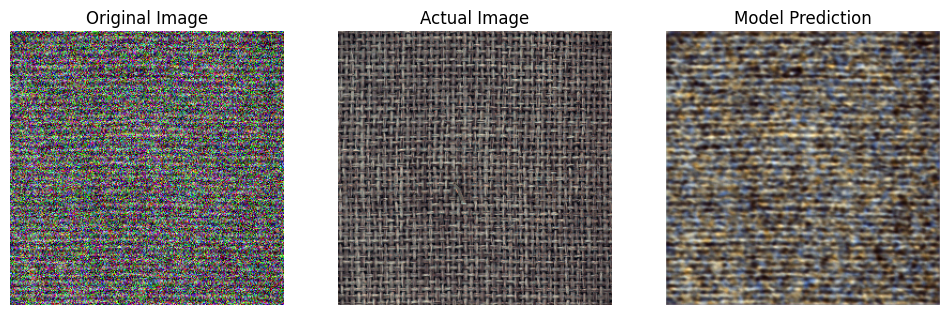

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


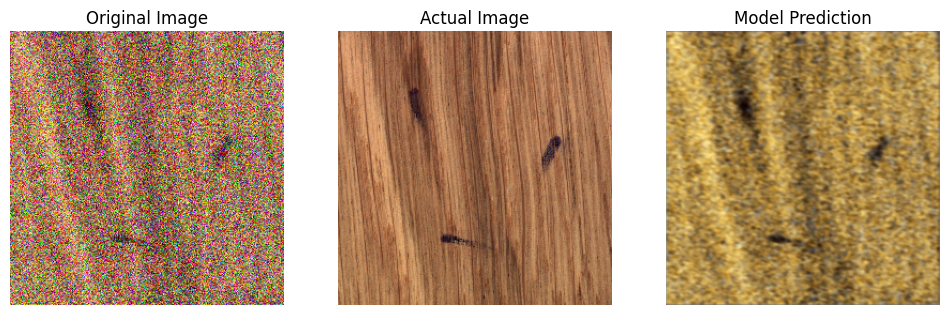

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


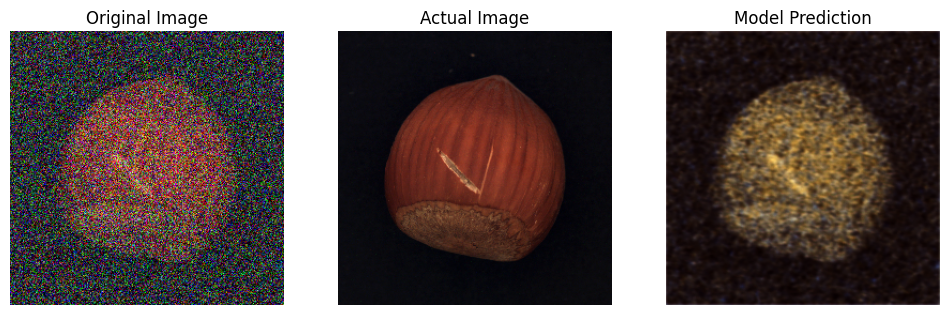

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


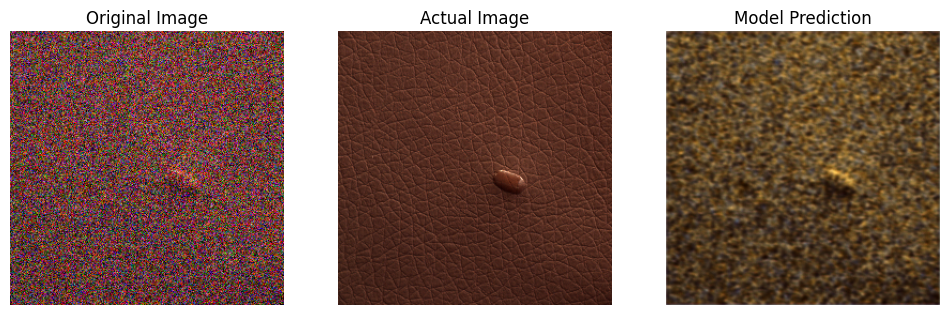

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


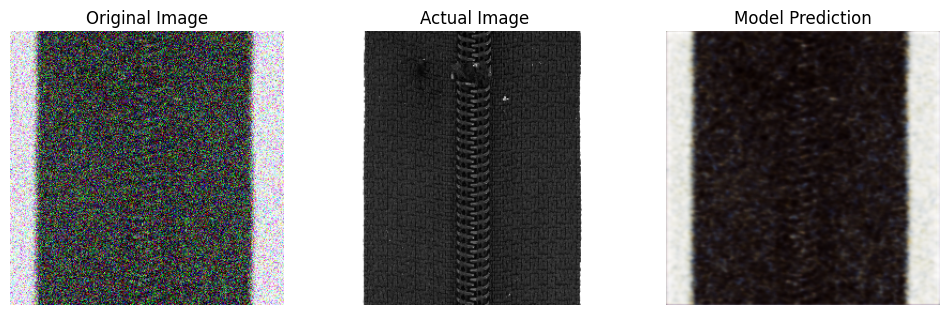

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


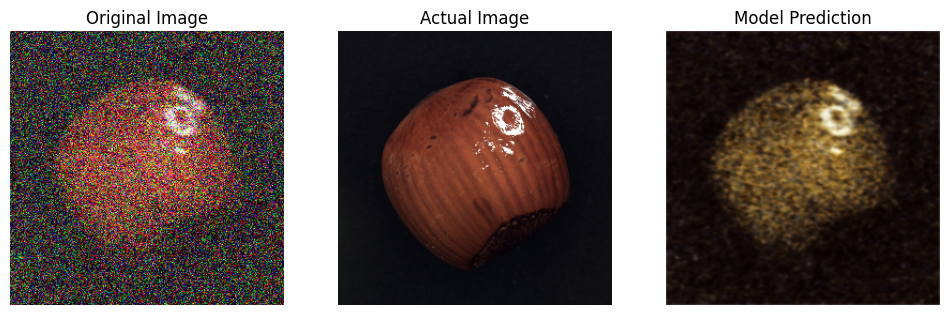

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


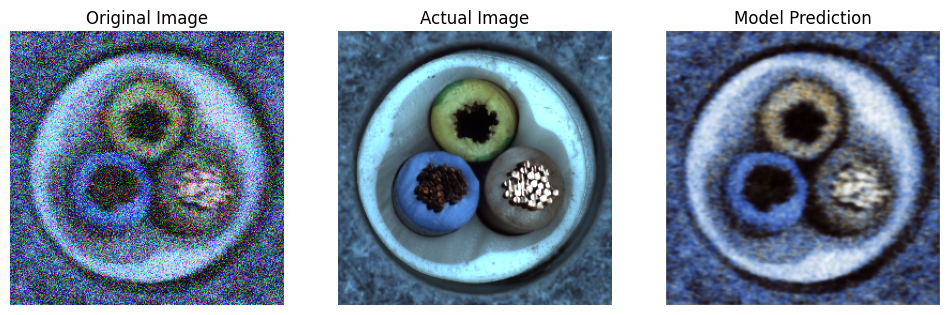

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


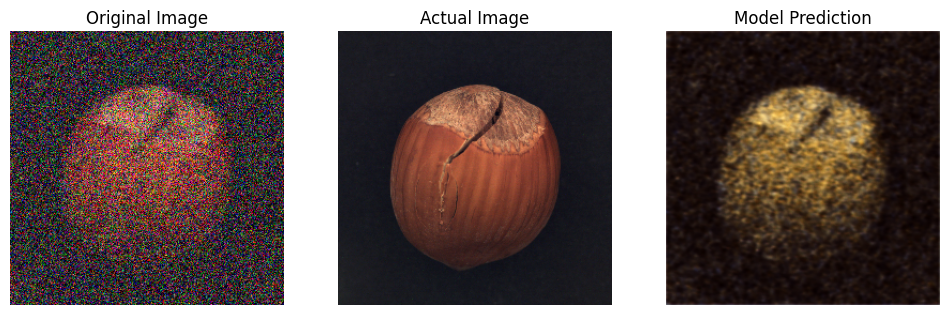

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


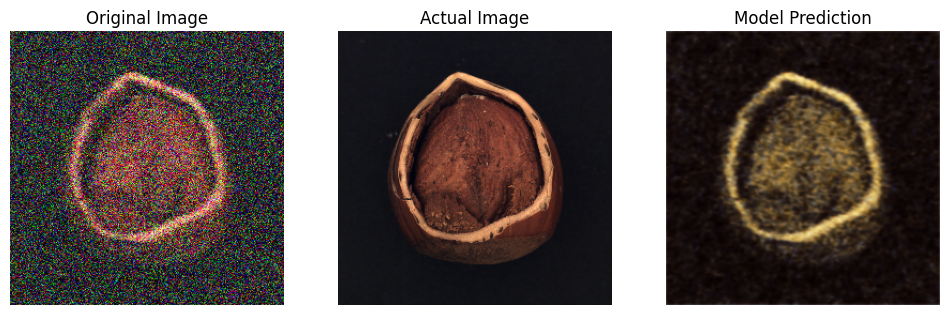

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


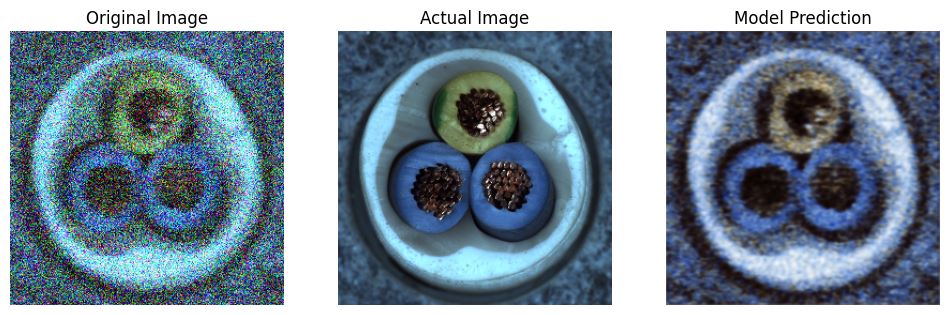

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


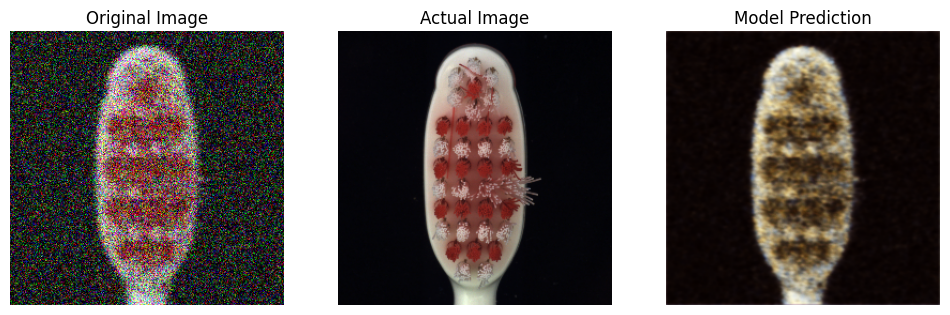

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


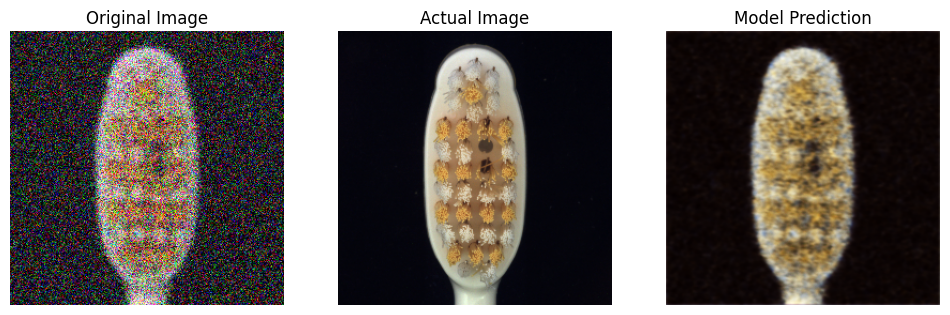

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


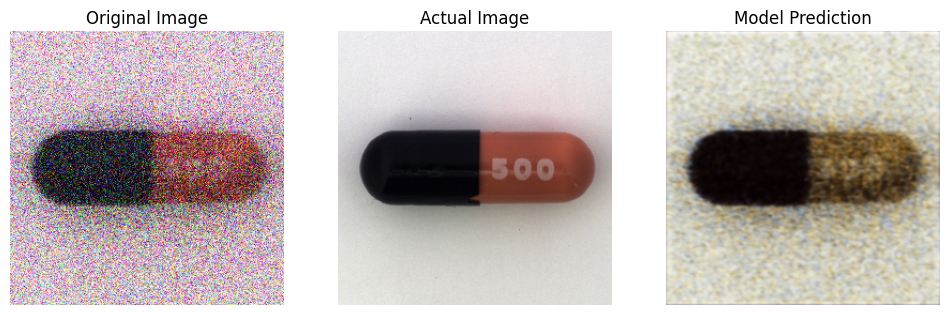

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


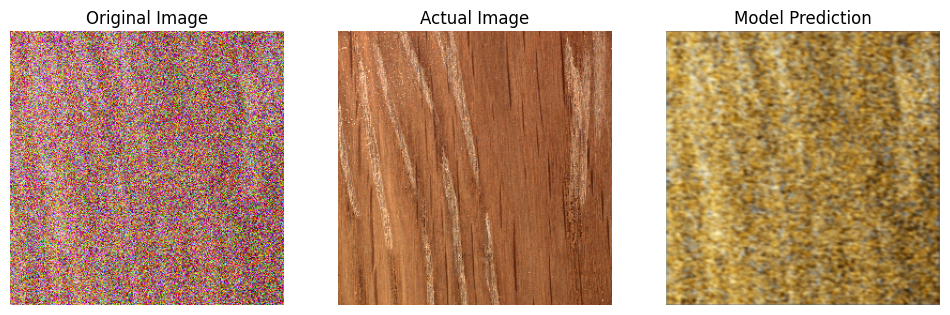

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step


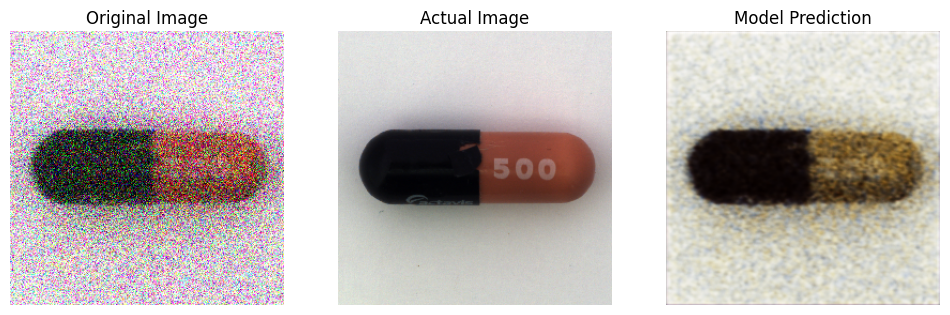

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


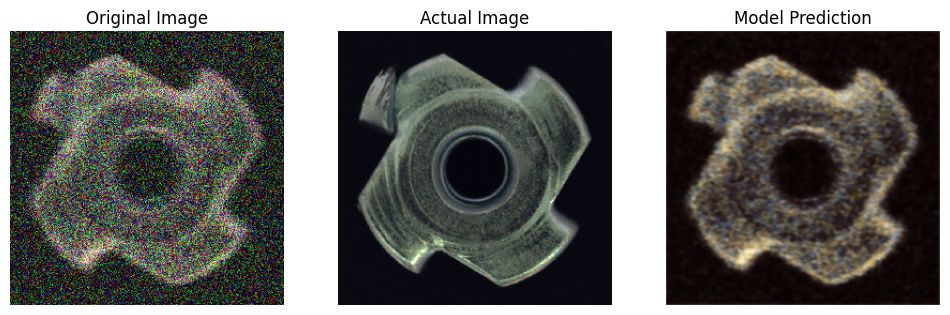

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


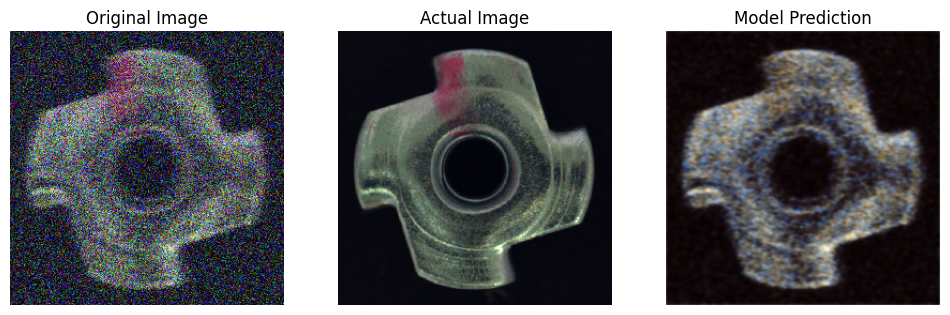

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


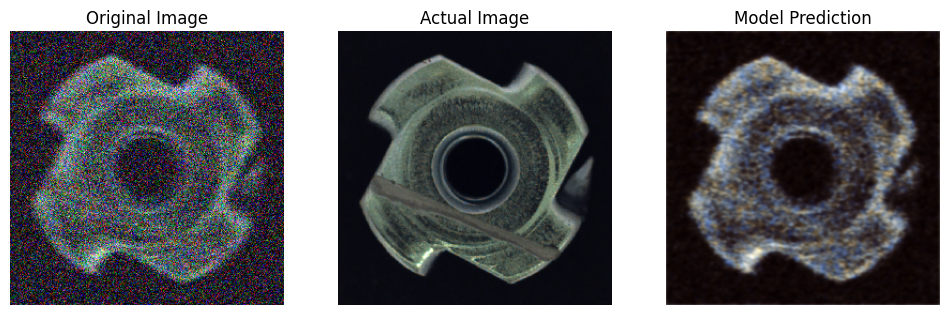

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


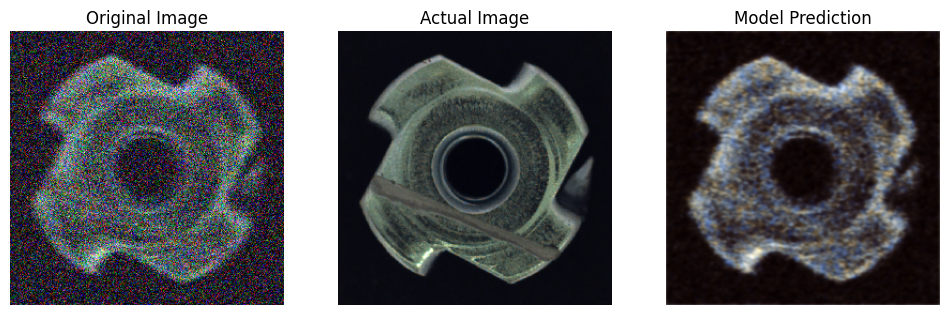

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step


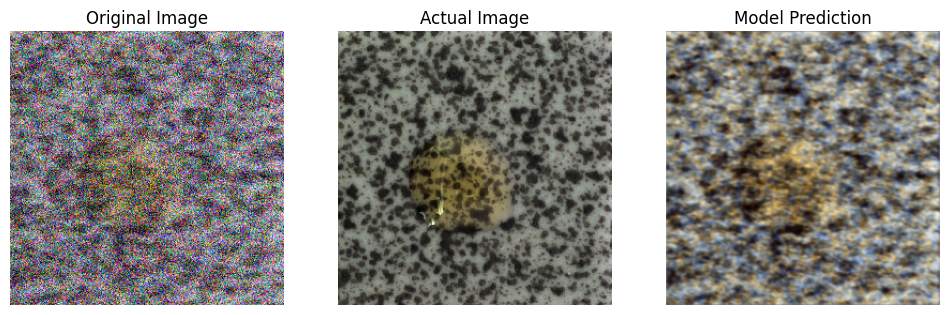

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


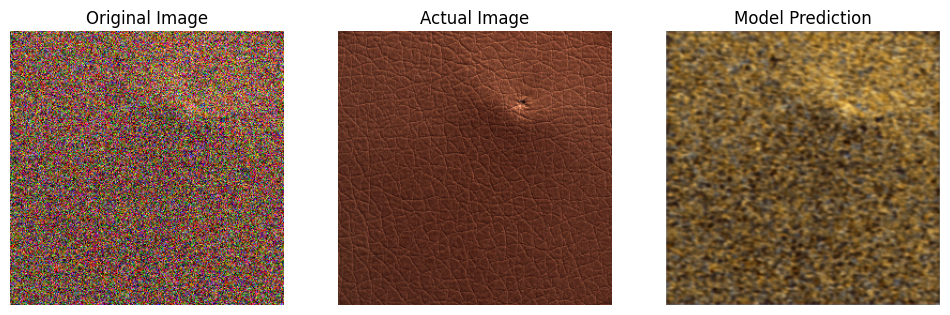

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


In [ ]:
for i in range(50):
  j = np.random.randint(0, len(val))
  image_path = val.iloc[j]['Degraded_image']
  actual_path = val.iloc[j]['GT_clean_image']
  predict_and_display(image_path, actual_path, model)